In [153]:
#Importing our Packages: Analytics
import pandas as pd
import numpy as np

#Viz libaries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as ply

#Data_libraries
import pymysql
import sqlalchemy


#Sklearn libraries
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression , Ridge , Lasso

#Scoring libraries
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as rmse
from sklearn.metrics import r2_score

<AxesSubplot:>

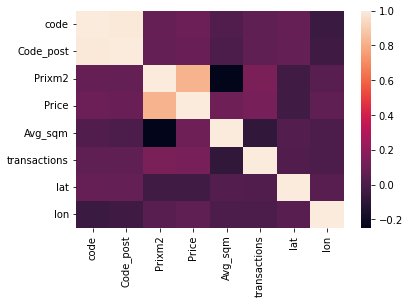

In [263]:
#Create String for data creation
querystring = """SELECT dwu.code_commune AS code,
dwu.type_local AS type,   
dwu.nom_commune AS commune,
dwu.code_postal AS Code_post,
ROUND(AVG(dwu.valeur_fonciere/dwu.surface_reelle_bati),0) AS Prixm2,
ROUND(AVG(dwu.valeur_fonciere),0) AS Price,
ROUND(AVG(dwu.surface_reelle_bati),0) AS Avg_sqm,
COUNT(dwu.id_mutation) AS transactions,
MAX(dwu.latitude) AS lat,
MAX(dwu.longitude) AS lon
FROM data_working_update dwu
WHERE dwu.type_local IN('Appartement', 'Maison')
GROUP BY code_commune, Code_post, nom_commune, dwu.type_local;
"""

#Load Libraries and Create engine Connection

engine =sqlalchemy.create_engine(
        sqlalchemy.engine.url.URL.create(
        drivername="mysql+pymysql",
        username='Estimators',  # e.g. "my-database-user"
        password='Estimator2021',  # e.g. "my-database-password"
        host='34.77.88.127',  # e.g. "127.0.0.1"
        port=3306,  # e.g. 3306
        database='Housing_France',  # e.g. "my-database-name"
    ))

conn = engine.connect().execution_options(stream_results=True)    

def get_data(querystring,chunk):
    engine =sqlalchemy.create_engine(
    sqlalchemy.engine.url.URL.create(
    drivername="mysql+pymysql",
    username='Estimators',  #
    password='Estimator2021',  # e.g. "my-database-password"
    host='34.77.88.127',  # e.g. "127.0.0.1"
    port=3306,  # e.g. 3306
    database='Housing_France',  # e.g. "my-database-name"
    ))
    conn = engine.connect().execution_options(stream_results=True)
    frame = pd.DataFrame()
    for chunk_dataframe in pd.read_sql(
            querystring, conn, chunksize=chunk):
            #print(f"Got dataframe w/{len(chunk_dataframe)} rows")
            frame= frame.append(chunk_dataframe)

            # ... do something with dataframe ...
            
    return frame
#Get data from Mysql on Gcloud
df = get_data(querystring, 100000)


import requests
url = 'https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/communes-version-simplifiee.geojson'
response =  requests.get(url).json()

In [269]:
df2 = df[df['type'] == data['type']]
geodf = df2[['commune','transactions']]


(250.0, 107279.5)

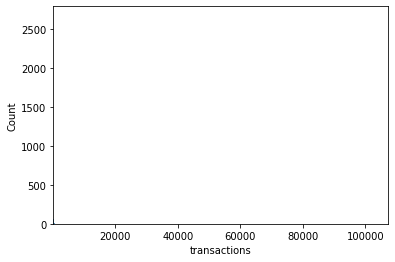

In [273]:
sns.histplot(geodf['transactions'])
plt.xlim(250)

In [270]:
def transform_string(string, separator):
    L = string.split(separator)
    return L[0] if L[0] in ['Paris', 'Marseille', 'Lyon'] else L[0]

geodf.commune = geodf.commune.apply(lambda x: transform_string(x,' '))
geodf = geodf.groupby(geodf.commune).sum().reset_index(drop=False)


# import the folium library
import folium

# initialize the map and store it in a m object
m = folium.Map(location=[data['lat'], data['lon']], zoom_start=11)

# show the map
m
folium.Choropleth(
    geo_data=response,
    name="choropleth",
    data=geodf,
    columns=["commune", "transactions"],
    key_on= "feature.properties.nom",
    fill_color="OrRd",
    fill_opacity=0.8,
    line_opacity=.01,
    legend_name="transaction par commune",
    nan_fill_color='white'
).add_to(m)

folium.Marker(
    location=[data['lat'], data['lon']],
    popup=pd.DataFrame.from_dict(data, orient='index', columns=[data['commune']]),
    icon=folium.Icon(color="red", icon="accessible-icon"),
).add_to(m)

folium.LayerControl().add_to(m)

m



/home/julienlefebvre/.pyenv/versions/3.8.6/envs/Housing/lib/python3.8/site-packages/pandas/core/generic.py:5516: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [158]:
df.head()

,code,type,commune,Code_post,Prixm2,Price,Avg_sqm,transactions,lat,lon
0,1370,Appartement,Saint-Laurent-sur-Saône,1750,1826.0,111633.0,65.0,181,46.309896,4.843260
1,1364,Maison,Saint-Jean-sur-Reyssouze,1560,1457.0,160808.0,116.0,66,46.422331,5.086478
2,1050,Maison,Boissey,1190,1625.0,158847.0,101.0,24,46.385467,5.014012
3,1024,Maison,Attignat,1340,1874.0,201769.0,110.0,168,46.296934,5.199541
4,1130,Maison,Bresse Vallons,1340,1800.0,198536.0,111.0,132,46.345067,5.217463


In [258]:
#numero commmune = 1024
code_commune = 1200
type_bati = 'Maison'
data = df[(df['code'] == code_commune)& (df['type'] == type_bati)].reset_index(drop=True).to_dict(orient='records')[0]

{'code': 1024,
 'type': 'Maison',
 'Year': 2016,
 'commune': 'Attignat',
 'Prixm2': 1683.0,
 'Price': 191936.0,
 'Avg_sqm': 119.0,
 'transactions': 50,
 'lat': 46.296672,
 'lon': 5.195046}

In [242]:
#House price and transactions evolution over years
query2 ="""SELECT dwu.code_commune AS code,
dwu.type_local AS type,  
year(dwu.date_mutation) AS 'Year', 
dwu.nom_commune AS commune,
ROUND(AVG(dwu.valeur_fonciere/dwu.surface_reelle_bati),0) AS Prixm2,
ROUND(AVG(dwu.valeur_fonciere),0) AS Price,
ROUND(AVG(dwu.surface_reelle_bati),0) AS Avg_sqm,
COUNT(dwu.id_mutation) AS transactions,
MAX(dwu.latitude) AS lat,
MAX(dwu.longitude) AS lon
FROM data_working_update dwu
WHERE dwu.type_local IN('Appartement', 'Maison')
GROUP BY code_commune, nom_commune, dwu.type_local, year(dwu.date_mutation)"""

#Get data from Mysql on Gcloud
df3 = get_data(query2, 100000)
df.tail(10)

,code,type,Year,commune,Prixm2,Price,Avg_sqm,transactions,lat,lon
97153,75117,Appartement,2020,Paris 17e Arrondissement,14898.0,740143.0,56.0,2618,48.897322,2.328454
97154,75117,Maison,2020,Paris 17e Arrondissement,14202.0,1668526.0,117.0,11,48.896927,2.324412
97155,75118,Appartement,2020,Paris 18e Arrondissement,14667.0,543723.0,41.0,3469,48.900630,2.365362
97156,75118,Maison,2020,Paris 18e Arrondissement,15852.0,1629123.0,115.0,9,48.897645,2.343931
97157,75119,Appartement,2020,Paris 19e Arrondissement,13312.0,495176.0,45.0,1905,48.899240,2.407273
97158,75120,Appartement,2020,Paris 20e Arrondissement,16244.0,582236.0,43.0,2105,48.876153,2.411016
97159,75120,Maison,2020,Paris 20e Arrondissement,12824.0,1213071.0,95.0,20,48.872035,2.408233
97160,75119,Maison,2020,Paris 19e Arrondissement,15566.0,1378126.0,101.0,25,48.887286,2.400823
97161,75104,Appartement,2020,Paris 4e Arrondissement,18533.0,774827.0,51.0,540,48.861645,2.368462
97162,75102,Appartement,2020,Paris 2e Arrondissement,14121.0,567035.0,43.0,492,48.871602,2.353867


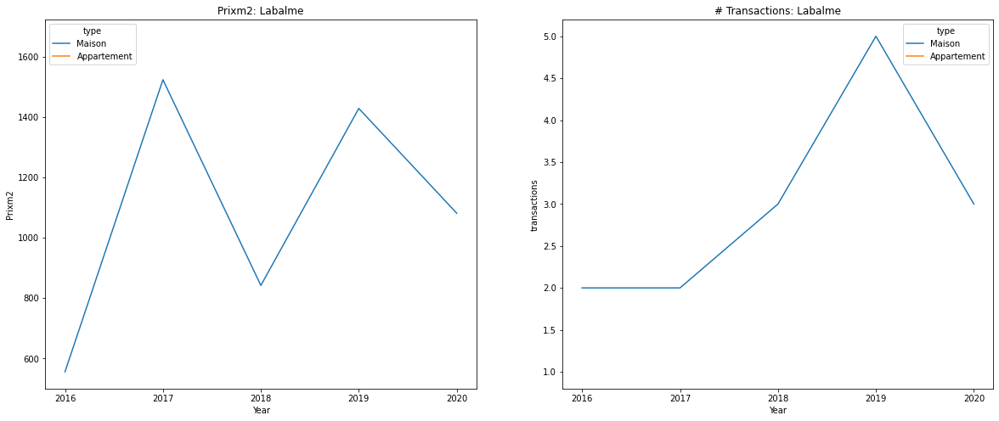

In [279]:

#Create 
df_time = df3[['code','Year','commune', 'type','Prixm2','transactions']]
#df_time = df_time[df_time['type']==type_bati]
df_time = df_time[df_time['code']==code_commune]
df_time.commune = df_time.commune.apply(lambda x: transform_string(x,' '))
df_time =df_time.groupby(['commune','Year','type']).agg({
                                             'Prixm2':'mean',
                                             'transactions':'sum'}).reset_index(drop=False)
df_time.drop(columns='transactions')

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,8))
sns.lineplot(data =df_time, x=df_time.Year.astype('str'), y='Prixm2', hue='type', ax=ax1)
ax1.title.set_text(f"Prixm2: {data['commune']}")
sns.lineplot(data =df_time, x=df_time.Year.astype('str'), y='transactions', hue='type', ax=ax2)
ax2.title.set_text(f"# Transactions: {data['commune']}")
plt.show()
